# MMA - 869 - Machine Learning

## [Pump it Up - Data Mining the Water Table](https://www.drivendata.org/competitions/7/pump-it-up-data-mining-the-water-table/)

### Hosted by DataDriven

## Team Alfred
- Sushant Karmakar
- Sushil Megharaj
- Jacqueline Mak
- Faiza Shallwani
- Crystal Fang
- Eddie Wang
- Gopala Goyal

### Environment Setup

In [1]:
#!pip install lightgbm

In [45]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', 40)
import matplotlib.pyplot as plt
import seaborn as sns
from shapely.geometry import Point
import geopandas as gpd
from geopandas import GeoDataFrame
from sklearn.impute import KNNImputer
import pandas_profiling
import sweetviz
import re
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from category_encoders import TargetEncoder
from sklearn.neighbors import KNeighborsClassifier
import geopy.distance as gp
%matplotlib inline

In [2]:
df_ = pd.read_csv("training_set_values.csv", parse_dates = ['date_recorded'])
df_lab_ = pd.read_csv("training_set_labels.csv")

In [3]:
df_.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58,True,GeoData Consultants Ltd,VWC,NaN,True,1986,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe


In [78]:
print(df_.water_quality.unique())
ctr = 0
for _ in df_.water_quality.unique():
    ctr += 1
    print(df_.loc[(df_.water_quality == _)]['quality_group'].unique())
print(ctr)

print(df_.quality_group.unique())

['soft' 'salty' 'milky' 'unknown' 'fluoride' 'coloured' 'salty abandoned'
 'fluoride abandoned']
['good']
['salty']
['milky']
['unknown']
['fluoride']
['colored']
['salty']
['fluoride']
8
['good' 'salty' 'milky' 'unknown' 'fluoride' 'colored']


In [6]:
df_.describe()

,id,amount_tsh,gps_height,longitude,latitude,num_private,region_code,district_code,population,construction_year
count,59400.000000,59400.000000,59400.000000,59400.000000,5.940000e+04,59400.000000,59400.000000,59400.000000,59400.000000,59400.000000
mean,37115.131768,317.650385,668.297239,34.077427,-5.706033e+00,0.474141,15.297003,5.629747,179.909983,1300.652475
std,21453.128371,2997.574558,693.116350,6.567432,2.946019e+00,12.236230,17.587406,9.633649,471.482176,951.620547
min,0.000000,0.000000,-90.000000,0.000000,-1.164944e+01,0.000000,1.000000,0.000000,0.000000,0.000000
25%,18519.750000,0.000000,0.000000,33.090347,-8.540621e+00,0.000000,5.000000,2.000000,0.000000,0.000000
50%,37061.500000,0.000000,369.000000,34.908743,-5.021597e+00,0.000000,12.000000,3.000000,25.000000,1986.000000
75%,55656.500000,20.000000,1319.250000,37.178387,-3.326156e+00,0.000000,17.000000,5.000000,215.000000,2004.000000
max,74247.000000,350000.000000,2770.000000,40.345193,-2.000000e-08,1776.000000,99.000000,80.000000,30500.000000,2013.000000


In [72]:
df_.isna().sum()

id                           0
amount_tsh                   0
date_recorded                0
funder                    3635
gps_height                   0
installer                 3655
longitude                    0
latitude                     0
wpt_name                     0
num_private                  0
basin                        0
subvillage                 371
region                       0
region_code                  0
district_code                0
lga                          0
ward                         0
population                   0
public_meeting            3334
recorded_by                  0
scheme_management         3877
scheme_name              28166
permit                    3056
construction_year            0
extraction_type              0
extraction_type_group        0
extraction_type_class        0
management                   0
management_group             0
payment                      0
payment_type                 0
water_quality                0
quality_

In [8]:
# #Generate Profiling Report for the dataset - EDA
# profile = df_.profile_report(
#     title="Profile Report",
#     correlations={
#         "pearson": {"calculate": True},
#         "spearman": {"calculate": False},
#         "kendall": {"calculate": False},
#         "phi_k": {"calculate": False},
#         "cramers": {"calculate": False},
#     },
# )
# profile.to_notebook_iframe()

> Seems one of the longitude is not at the right point -> This needs to be fixed -> Would use imputations

## Data Cleanup/Pre-Processing

In [3]:
df_w = df_.copy()

In [4]:
df_w.loc[df_w['longitude'] == 0, 'longitude'] = np.nan

In [5]:
df_w[df_w['longitude'] == 0]

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group


In [6]:
#Impute the NANs created above with values according to the Imputation/KNN
imputer = KNNImputer(n_neighbors=3, weights="uniform")
df_w['longitude'] = imputer.fit_transform(df_w[['longitude']])

In [7]:
#Remove the unnecessary columns

df_w.drop(columns=['wpt_name',
                   'num_private',
                   'subvillage',
                   'region_code',
                   'scheme_name',
                   'recorded_by',
                   'payment',
                   'water_quality',
                   'extraction_type_group',
                   'management_group',
                   'quantity_group',
                   'source_type',
                   'waterpoint_type'], inplace= True)

In [8]:
#Add the target variable to the main dataframe and encode it with the values 0, 1 and 2

df_w['status_group'] = pd.Series(df_lab_['status_group']).map({"functional":0,"non functional":1,"functional needs repair":2})

In [9]:
#Impute the variable construction year on the basis of region and district code

df_w['construction_year'].replace(0.0, np.nan, inplace=True)
df_w["construction_year"].fillna(df_w.groupby(['region', 'district_code'])["construction_year"].transform("median"), inplace=True)
df_w["construction_year"].fillna(df_w.groupby(['region'])["construction_year"].transform("median"), inplace=True)
df_w["construction_year"].fillna(df_w.groupby(['district_code'])["construction_year"].transform("median"), inplace=True)
df_w["construction_year"].fillna(df_w["construction_year"].median(), inplace=True)

In [64]:
df_w['population'].replace(0.0, np.nan, inplace=True)
df_w["population"].fillna(df_w.groupby(['region', 'district_code'])["population"].transform("mean"), inplace=True)
df_w["population"].fillna(df_w.groupby(['region'])["population"].transform("mean"), inplace=True)
df_w["population"].fillna(df_w.groupby(['district_code'])["population"].transform("mean"), inplace=True)
df_w["population"].fillna(df_w["population"].mean(), inplace=True)

In [10]:
# A function defined to create features from Date_recorded column
# This comes in handy while using tree based algorithms as those don't support categorical variables

def add_datepart(df, fldname):
    fld = df[fldname]
    targ_pre = re.sub('[Dd]ate$','', fldname)
    for n in ('Year', 'Month', 'Week', 'Day', 'Dayofweek', 'Dayofyear',
             'Is_month_end', 'Is_month_start', 'Is_quarter_end', 'Is_quarter_start',
             'Is_year_end', 'Is_year_start'):
        df[targ_pre+n] = getattr(fld.dt,n.lower())
    df[targ_pre+'Elapsed'] = (fld - fld.min()).dt.days
    df.drop(fldname, axis=1, inplace=True)

In [11]:
#Use the above function to create additional features from Date column and drop the date column after features are created

add_datepart(df_w, 'date_recorded')

/Users/apple/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.
  # Remove the CWD from sys.path while we load stuff.


In [42]:
mean_dodoma_long = df_w.loc[df_w['region'] == 'Dodoma']['longitude'].mean()
mean_dodoma_lat = df_w.loc[df_w['region'] == 'Dodoma']['latitude'].mean()

In [60]:
def fun(dframe):
    try:
        return gp.distance((dframe['latitude'],dframe['longitude']),(mean_dodoma_lat, mean_dodoma_long)).km
    except:
        return 0
df_w['distance_to_capital'] = df_w.apply(fun, axis = 1)


In [74]:
df_w.describe()

,id,amount_tsh,gps_height,longitude,latitude,district_code,population,construction_year,status_group,date_recordedYear,date_recordedMonth,date_recordedWeek,date_recordedDay,date_recordedDayofweek,date_recordedDayofyear,date_recordedElapsed,distance_to_capital
count,59400.000000,59400.000000,59400.000000,59400.000000,5.940000e+04,59400.000000,59400.000000,59400.000000,59400.000000,59400.000000,59400.000000,59400.000000,59400.000000,59400.000000,59400.000000,59400.000000,59400.000000
mean,37115.131768,317.650385,668.297239,35.149669,-5.706033e+00,5.629747,291.933544,1998.288485,0.529596,2011.921667,4.375640,17.137677,15.621498,2.939933,117.567138,3454.383030,411.270460
std,21453.128371,2997.574558,693.116350,2.567349,2.946019e+00,9.633649,463.223380,10.495941,0.628080,0.958758,3.029247,12.919245,8.687553,1.951627,90.921315,334.216374,168.162584
min,0.000000,0.000000,-90.000000,29.607122,-1.164944e+01,0.000000,1.000000,1960.000000,0.000000,2002.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.225489
25%,18519.750000,0.000000,0.000000,33.354079,-8.540621e+00,2.000000,80.000000,1995.000000,0.000000,2011.000000,2.000000,8.000000,8.000000,1.000000,53.000000,3091.000000,295.620401
50%,37061.500000,0.000000,369.000000,35.149669,-5.021597e+00,3.000000,200.000000,2001.000000,0.000000,2012.000000,3.000000,11.000000,16.000000,3.000000,78.000000,3649.000000,392.870453
75%,55656.500000,20.000000,1319.250000,37.178387,-3.326156e+00,5.000000,430.000000,2005.000000,1.000000,2013.000000,7.000000,29.000000,23.000000,5.000000,199.000000,3771.000000,532.903847
max,74247.000000,350000.000000,2770.000000,40.345193,-2.000000e-08,80.000000,30500.000000,2013.000000,2.000000,2013.000000,12.000000,52.000000,31.000000,6.000000,359.000000,4068.000000,805.137311


In [15]:
#Generate Profiling Report for the dataset - EDA
profile = df_w.profile_report(
    title="Profile Report",
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": False},
        "kendall": {"calculate": False},
        "phi_k": {"calculate": False},
        "cramers": {"calculate": False},
    },
)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [75]:
#Separate out the list of numerical and categorical features

numerical_features = list(df_w.select_dtypes(exclude=['object']))
categorical_features = list(df_w.select_dtypes(include=['object']))

In [87]:
#Generate Profiling Report for the dataset - EDA
profile = df_w.profile_report(
    title="Profile Report",
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": False},
        "kendall": {"calculate": False},
        "phi_k": {"calculate": False},
        "cramers": {"calculate": False},
    },
)


In [76]:
cardinal_features = ['funder','installer','lga','ward']

In [91]:
profile.to_notebook_iframe()

In [32]:
# #Performing Target Encoding for the categorical features
# from category_encoders import TargetEncoder
# encoder = TargetEncoder(cols=categorical_features)
# df_w[categorical_features] = encoder.fit_transform(df_w[categorical_features], df_w['status_group'])

In [77]:
df_w.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,basin,region,district_code,lga,ward,population,public_meeting,scheme_management,permit,construction_year,extraction_type,extraction_type_class,management,...,quality_group,quantity,source,source_class,waterpoint_type_group,status_group,date_recordedYear,date_recordedMonth,date_recordedWeek,date_recordedDay,date_recordedDayofweek,date_recordedDayofyear,date_recordedIs_month_end,date_recordedIs_month_start,date_recordedIs_quarter_end,date_recordedIs_quarter_start,date_recordedIs_year_end,date_recordedIs_year_start,date_recordedElapsed,distance_to_capital
0,69572,6000.0,Roman,1390,Roman,34.938093,-9.856322,Lake Nyasa,Iringa,5,Ludewa,Mundindi,109.0,True,VWC,False,1999.0,gravity,gravity,vwc,...,good,enough,spring,groundwater,communal standpipe,0,2011,3,11,14,0,73,False,False,False,False,False,False,3073,451.166543
1,8776,0.0,Grumeti,1399,GRUMETI,34.698766,-2.147466,Lake Victoria,Mara,2,Serengeti,Natta,280.0,NaN,Other,True,2010.0,gravity,gravity,wug,...,good,insufficient,rainwater harvesting,surface,communal standpipe,0,2013,3,10,6,2,65,False,False,False,False,False,False,3796,444.013256
2,34310,25.0,Lottery Club,686,World vision,37.460664,-3.821329,Pangani,Manyara,4,Simanjiro,Ngorika,250.0,True,VWC,True,2009.0,gravity,gravity,vwc,...,good,enough,dam,surface,communal standpipe,0,2013,2,9,25,0,56,False,False,False,False,False,False,3787,281.054063
3,67743,0.0,Unicef,263,UNICEF,38.486161,-11.155298,Ruvuma / Southern Coast,Mtwara,63,Nanyumbu,Nanyumbu,58.0,True,VWC,True,1986.0,submersible,submersible,vwc,...,good,dry,machine dbh,groundwater,communal standpipe,1,2013,1,5,28,0,28,False,False,False,False,False,False,3759,637.473545
4,19728,0.0,Action In A,0,Artisan,31.130847,-1.825359,Lake Victoria,Kagera,1,Karagwe,Nyakasimbi,200.0,True,NaN,True,2003.0,gravity,gravity,other,...,good,seasonal,rainwater harvesting,surface,communal standpipe,0,2011,7,28,13,2,194,False,False,False,False,False,False,3194,709.615923


1. What is the population growth?
2. Construction Year -> Impact of age is significant for functional/non-functional pumps
3. Add basin coordinates and calculate distance from pump, check the status
4. 

In [127]:
df_w.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59400 entries, 0 to 59399
Data columns (total 41 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   id                             59400 non-null  int64  
 1   amount_tsh                     59400 non-null  float64
 2   funder                         55765 non-null  object 
 3   gps_height                     59400 non-null  int64  
 4   installer                      55745 non-null  object 
 5   longitude                      59400 non-null  float64
 6   latitude                       59400 non-null  float64
 7   basin                          59400 non-null  object 
 8   region                         59400 non-null  object 
 9   district_code                  59400 non-null  int64  
 10  lga                            59400 non-null  object 
 11  ward                           59400 non-null  object 
 12  population                     59400 non-null 

In [110]:
#Construction Year 
df_group = df_w.groupby(["construction_year", "status_group"])["id"].count()

# Explore using PyCaret

In [80]:
from pycaret.classification import *
exp_ = setup(data = df_w, 
             target = 'status_group',
             train_size = 0.7,
             categorical_features= categorical_features,
             categorical_imputation = 'mode', 
             high_cardinality_features = cardinal_features,
             high_cardinality_method = 'frequency',
             remove_multicollinearity = True,
             remove_perfect_collinearity = True,
             fix_imbalance = True,
             pca = True,
             pca_components = 25,
             fold = 5, session_id=3)

,Description,Value
0,session_id,3
1,Target,status_group
2,Target Type,Multiclass
3,Label Encoded,None
4,Original Data,"(59400, 41)"
5,Missing Values,True
6,Numeric Features,12
7,Categorical Features,28
8,Ordinal Features,False
9,High Cardinality Features,True


In [81]:
exp_

(-1,
           id  amount_tsh           funder  gps_height     installer  \
 0      69572      6000.0            Roman        1390         Roman   
 1       8776         0.0          Grumeti        1399       GRUMETI   
 2      34310        25.0     Lottery Club         686  World vision   
 3      67743         0.0           Unicef         263        UNICEF   
 4      19728         0.0      Action In A           0       Artisan   
 ...      ...         ...              ...         ...           ...   
 59395  60739        10.0  Germany Republi        1210           CES   
 59396  27263      4700.0      Cefa-njombe        1212          Cefa   
 59397  37057         0.0              NaN           0           NaN   
 59398  31282         0.0            Malec           0          Musa   
 59399  26348         0.0       World Bank         191         World   
 
        longitude   latitude                    basin       region  \
 0      34.938093  -9.856322               Lake Nyasa      

In [88]:
clf = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
rf,Random Forest Classifier,0.7656,0.8798,0.6626,0.7664,0.7660,0.5758,0.5759,18.8300
et,Extra Trees Classifier,0.7592,0.8707,0.6555,0.7613,0.7602,0.5658,0.5658,6.4360
xgboost,Extreme Gradient Boosting,0.7546,0.8737,0.6642,0.7621,0.7579,0.5603,0.5606,79.3500
catboost,CatBoost Classifier,0.7512,0.8722,0.6621,0.7586,0.7544,0.5536,0.5540,38.1520
lightgbm,Light Gradient Boosting Machine,0.7381,0.8603,0.6543,0.7499,0.7429,0.5325,0.5333,6.4260
dt,Decision Tree Classifier,0.6903,0.7387,0.6026,0.7098,0.6986,0.4562,0.4575,2.1580
gbc,Gradient Boosting Classifier,0.6624,0.8125,0.6175,0.7111,0.6808,0.4273,0.4328,102.4420
ada,Ada Boost Classifier,0.5918,0.7403,0.5482,0.6570,0.6163,0.3242,0.3314,8.8500
ridge,Ridge Classifier,0.5719,0.0000,0.5624,0.6776,0.6091,0.3179,0.3330,0.5420
lda,Linear Discriminant Analysis,0.5712,0.7529,0.5622,0.6801,0.6091,0.3168,0.3325,0.7520


In [83]:
rf_m = create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7678,0.8797,0.6646,0.7683,0.7680,0.5793,0.5793
1,0.7696,0.8828,0.6703,0.7713,0.7704,0.5838,0.5838
2,0.7642,0.8780,0.6550,0.7640,0.7641,0.5727,0.5727
3,0.7587,0.8788,0.6562,0.7598,0.7592,0.5634,0.5634
4,0.7676,0.8796,0.6670,0.7689,0.7683,0.5800,0.5801
Mean,0.7656,0.8798,0.6626,0.7664,0.7660,0.5758,0.5759
SD,0.0039,0.0016,0.0060,0.0041,0.0040,0.0072,0.0072


In [84]:
print(rf_m)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=3, verbose=0,
                       warm_start=False)


In [98]:
params = {'bootstrap': [True, False],
          "criterion": ["gini", "entropy"],
          "class_weight": ['balanced', None], 
          "max_depth": np.random.randint(1, (len(df_w.columns)*.85),20),
          "min_samples_leaf": [np.random.randint(1, 11)],
          "max_features": np.random.randint(1, len(df_w.columns),20)}

In [136]:
tuned_rf = tune_model(rf_m, optimize = 'F1', custom_grid = params)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7671,0.8833,0.6804,0.7739,0.7701,0.5827,0.5829
1,0.7644,0.8865,0.6805,0.7760,0.7694,0.5808,0.5814
2,0.7630,0.8826,0.6705,0.7706,0.7664,0.5759,0.5761
3,0.7573,0.8829,0.6748,0.7669,0.7615,0.5673,0.5677
4,0.7636,0.8826,0.6801,0.7725,0.7675,0.5778,0.5782
Mean,0.7631,0.8836,0.6773,0.7720,0.7670,0.5769,0.5773
SD,0.0032,0.0015,0.0040,0.0031,0.0030,0.0053,0.0053


In [137]:
print(tuned_rf)

RandomForestClassifier(bootstrap=False, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=18, max_features=8,
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=4, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=3, verbose=0,
                       warm_start=False)


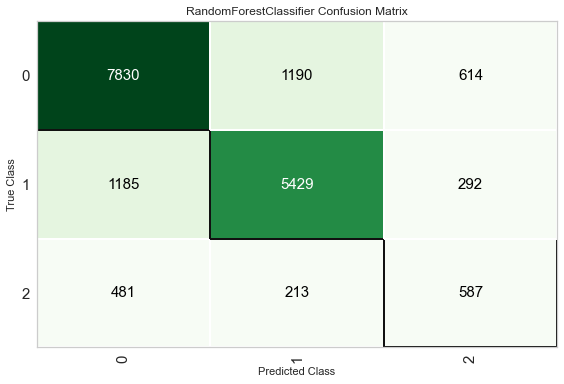

In [133]:
plot_model(rf_m, plot = 'confusion_matrix')

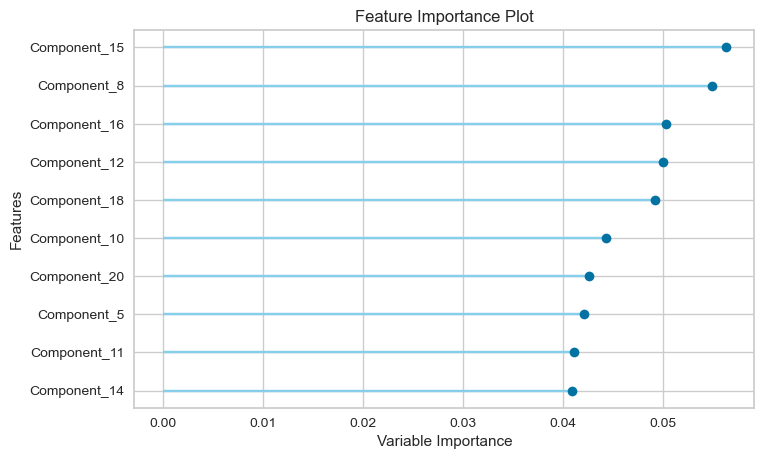

In [154]:
plot_model(rf_m, plot = 'feature')

In [45]:
predict_model(rf_m);

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,0.8012,0.9032,0.6713,0.7954,0.7965,0.6304,0.6323


In [46]:
final_knn = finalize_model(rf_m)

In [147]:
df_unseen = pd.read_csv("test_set_values.csv",parse_dates = ['date_recorded'])

In [148]:
df_unseen.drop(columns=['wpt_name',
                   'num_private',
                   'subvillage',
                   'region_code',
                   'scheme_name',
                   'recorded_by',
                   'payment',
                   'water_quality',
                   'extraction_type_group',
                   'management_group',
                   'quantity_group',
                   'source_type',
                   'waterpoint_type'], inplace= True)
add_datepart(df_unseen, 'date_recorded')
df_unseen['distance_to_capital'] = df_unseen.apply(fun, axis = 1)

In [149]:
unseen_predictions = predict_model(final_knn, data=df_unseen)
unseen_predictions.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,basin,region,district_code,...,date_recordedIs_month_end,date_recordedIs_month_start,date_recordedIs_quarter_end,date_recordedIs_quarter_start,date_recordedIs_year_end,date_recordedIs_year_start,date_recordedElapsed,distance_to_capital,Label,Score
0,50785,0.0,Dmdd,1996,DMDD,35.290799,-4.059696,Internal,Manyara,3,...,False,False,False,False,False,False,4333,222.929938,0,0.4301
1,51630,0.0,Government Of Tanzania,1569,DWE,36.656709,-3.309214,Pangani,Arusha,2,...,False,False,False,False,False,False,4333,297.536468,2,0.4028
2,17168,0.0,NaN,1567,NaN,34.767863,-5.004344,Internal,Singida,2,...,False,True,False,False,False,False,4330,174.508590,0,0.4350
3,45559,0.0,Finn Water,267,FINN WATER,38.058046,-9.418672,Ruvuma / Southern Coast,Lindi,43,...,False,False,False,False,False,False,4320,445.334700,1,0.7715
4,49871,500.0,Bruder,1260,BRUDER,35.006123,-10.950412,Ruvuma / Southern Coast,Ruvuma,3,...,False,False,False,False,False,False,4384,567.026078,0,0.5531


In [48]:
df_subm = unseen_predictions[['id', 'Label']]
df_subm = df_subm.rename(columns = {'Label': 'status_group'})
df_subm['status_group'] = pd.Series(df_subm['status_group']).map({0:"functional",1:"non functional",2:"functional needs repair"})
df_subm.to_csv("submission.csv", index = False)

### Hyperparameter Tuned Model - BAD

In [138]:
final_rf = finalize_model(tuned_rf)

In [150]:
unseen_predictions_tune = predict_model(final_rf, data=df_unseen)
unseen_predictions_tune.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,basin,region,district_code,...,date_recordedIs_month_end,date_recordedIs_month_start,date_recordedIs_quarter_end,date_recordedIs_quarter_start,date_recordedIs_year_end,date_recordedIs_year_start,date_recordedElapsed,distance_to_capital,Label,Score
0,50785,0.0,Dmdd,1996,DMDD,35.290799,-4.059696,Internal,Manyara,3,...,False,False,False,False,False,False,4333,222.929938,1,0.4385
1,51630,0.0,Government Of Tanzania,1569,DWE,36.656709,-3.309214,Pangani,Arusha,2,...,False,False,False,False,False,False,4333,297.536468,2,0.3980
2,17168,0.0,NaN,1567,NaN,34.767863,-5.004344,Internal,Singida,2,...,False,True,False,False,False,False,4330,174.508590,0,0.6060
3,45559,0.0,Finn Water,267,FINN WATER,38.058046,-9.418672,Ruvuma / Southern Coast,Lindi,43,...,False,False,False,False,False,False,4320,445.334700,1,0.9801
4,49871,500.0,Bruder,1260,BRUDER,35.006123,-10.950412,Ruvuma / Southern Coast,Ruvuma,3,...,False,False,False,False,False,False,4384,567.026078,0,0.7582


In [153]:
df_submm = unseen_predictions_tune[['id', 'Label']]
df_submm = df_submm.rename(columns = {'Label': 'status_group'})
df_submm['status_group'] = pd.Series(df_submm['status_group']).map({0:"functional",1:"non functional",2:"functional needs repair"})
df_submm.to_csv("submission_tune.csv", index = False)